## 2. Exploratory Data Analysis

Electricity demand, temperature and humidity time-series will be analyzed in the following way:

<li> Analysis and removal of outliers; <li> Visual analysis to infer any patterns or trends; </li> </li> <li> Normalize the data; </li> <li> Analysis of correlations between target (electricity demand) and features (weather variables, offset of demand). </li> 

In [17]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
import pickle

Electricity demand time-series
--

In [4]:
df = pd.read_pickle('demand_data')
df.head(5)

,meter_id,date,demand,hours
0,1,2005-01-01 00:00:00,3304.0,0.0
1,1,2005-01-01 01:00:00,3178.0,1.0
2,1,2005-01-01 02:00:00,2981.0,2.0
3,1,2005-01-01 03:00:00,2944.0,3.0
4,1,2005-01-01 04:00:00,2934.0,4.0


__a. Analysis and removal of outliers in electricity demand time-series__ 

Compute the difference between two consecutive values to identify the outliers:

In [5]:
diff = df.groupby('meter_id').apply(lambda g: g.demand.diff(periods=1))
df['diff_demand'] = diff.values.reshape(-1,1)

Plot the differences for first 5 meters:

/Users/anastasiagolubkova/anaconda3/envs/exts-ml/lib/python3.6/site-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


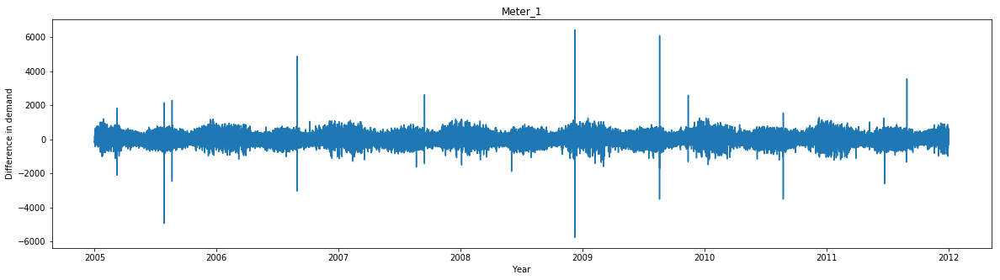

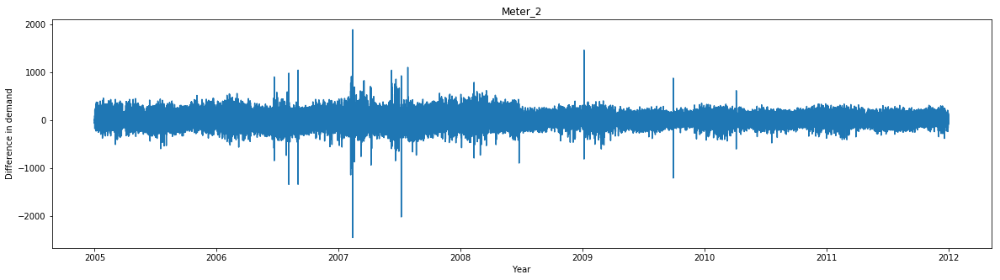

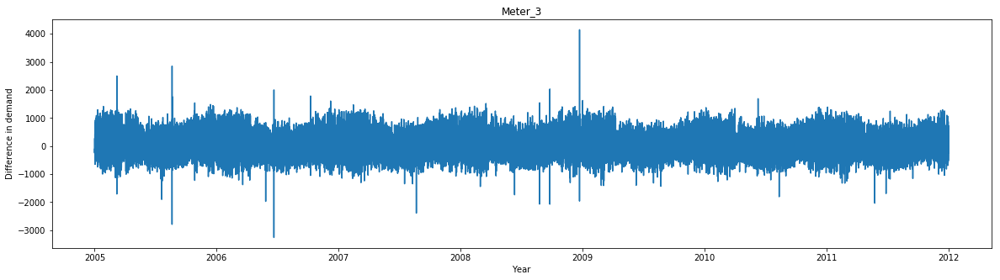

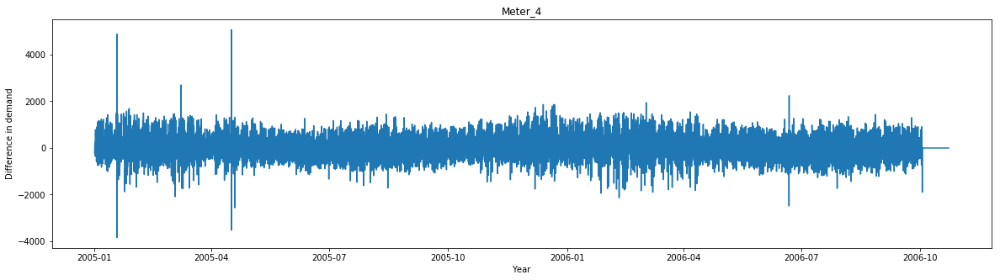

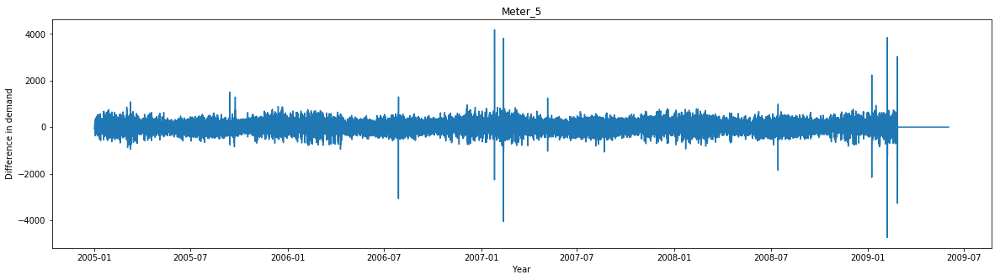

In [6]:
for i in np.arange(5)+1:
    plt.figure(figsize=(20,5))
    plt.plot(df[df.meter_id==i].date, df[df.meter_id==i].diff_demand)
    plt.xlabel('Year')
    plt.ylabel('Difference in demand')
    plt.title('Meter_'+i.astype(str))
    plt.show();

Plot the histograms of differences:

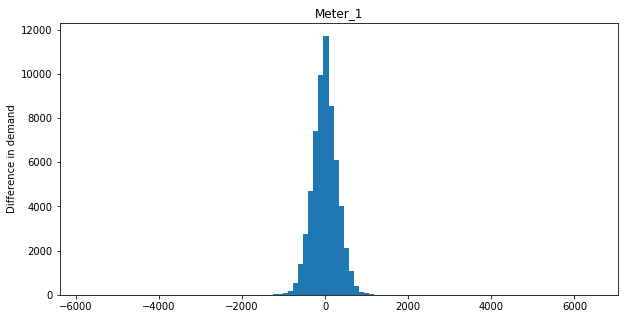

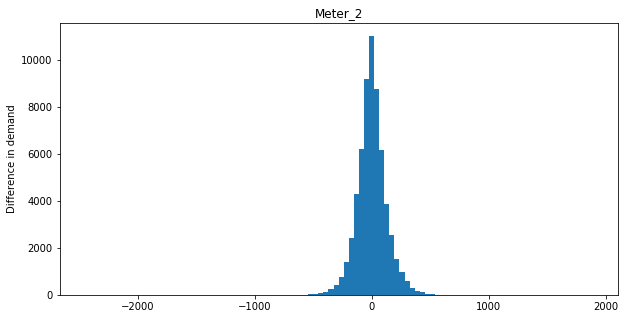

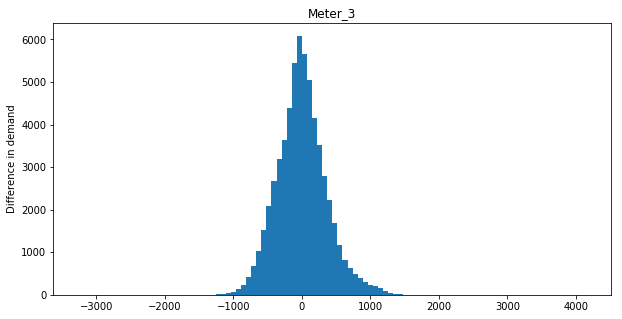

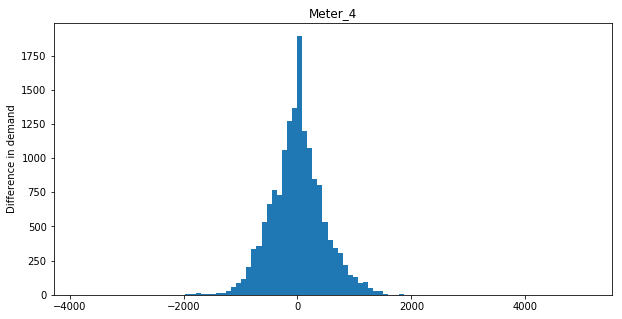

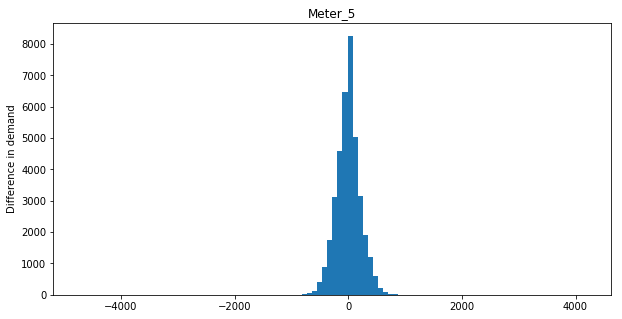

In [7]:
for i in np.arange(5)+1:
    plt.figure(figsize=(10,5))
    plt.hist(df[df.meter_id==i].diff_demand, bins=100)
    plt.ylabel('Difference in demand')
    plt.title('Meter_'+i.astype(str))
    plt.show();

Difference in demand computed for sample meters follow normal distribution, we can apply Z-scores algorithm to remove the outliers in demand for each meter:

In [8]:
mean_per_meter = df.groupby('meter_id').apply(lambda g: g.diff_demand.mean())
sd_per_meter = df.groupby('meter_id').apply(lambda g: g.diff_demand.std())

Same threshold, 3.0, will be applied to all meters: 99.8% of data points should lie in the range mean +/- threshold * standard deviation:

In [9]:
outliers = np.ones(1, dtype='bool')
threshold = 3.0
for id in df.meter_id.unique():
    meter_df = df[df['meter_id']==id]
    cond = np.abs(meter_df.diff_demand - mean_per_meter[id]) < threshold*sd_per_meter[id]
    outliers = np.append(outliers,cond)

# Drop first value
outliers = outliers[1:]

In [10]:
df['not_outlier'] = outliers.reshape(-1,1)

Outliers are replaced as an interpolation between 2 neighbouring values:

In [11]:
outlier_ind = df[df['not_outlier']==False].index

Keep very first element, others replace with NaN:

In [12]:
df.iloc[outlier_ind[1:], 2] = np.nan

In [13]:
df.demand.interpolate(inplace=True)

Compute the difference again and plot the results:

In [14]:
diff2 = df.groupby('meter_id').apply(lambda g: g.demand.diff(periods=1))
df['diff_demand2'] = diff2.values.reshape(-1,1)

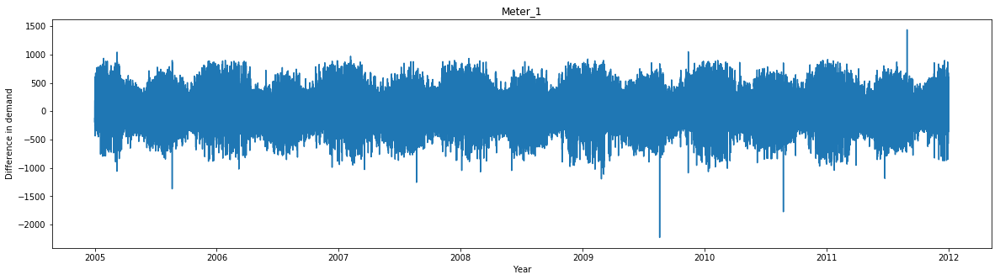

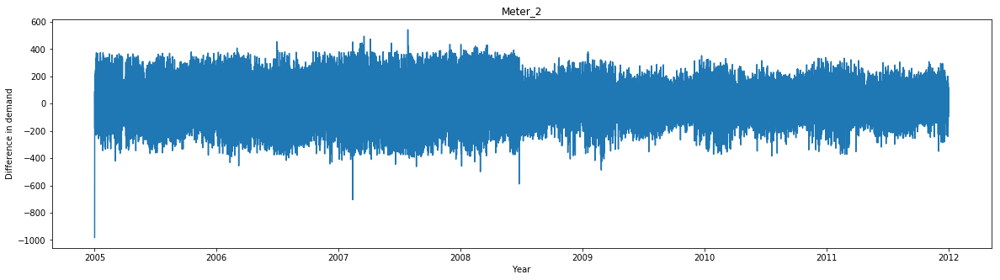

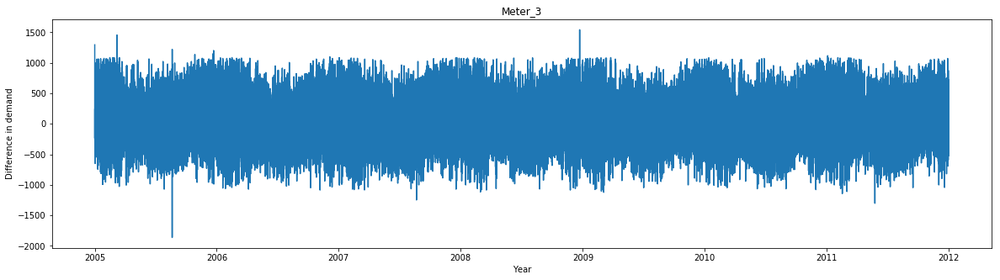

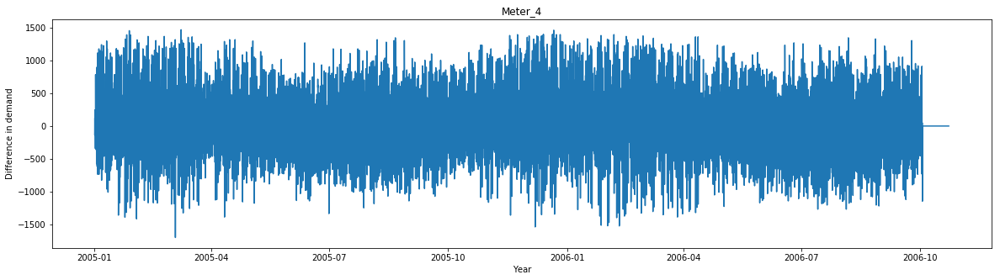

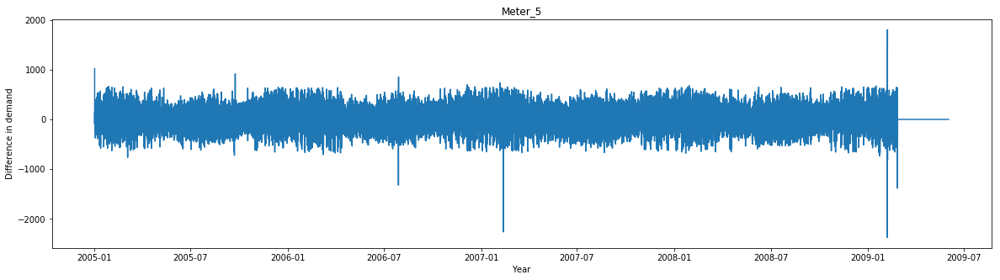

In [15]:
for i in np.arange(5)+1:
    plt.figure(figsize=(20,5))
    plt.plot(df[df.meter_id==i].date, df[df.meter_id==i].diff_demand2)
    plt.xlabel('Year')
    plt.ylabel('Difference in demand')
    plt.title('Meter_'+i.astype(str))
    plt.show();

__b. Visual analysis__

Plot electricity demand for 5 meters:

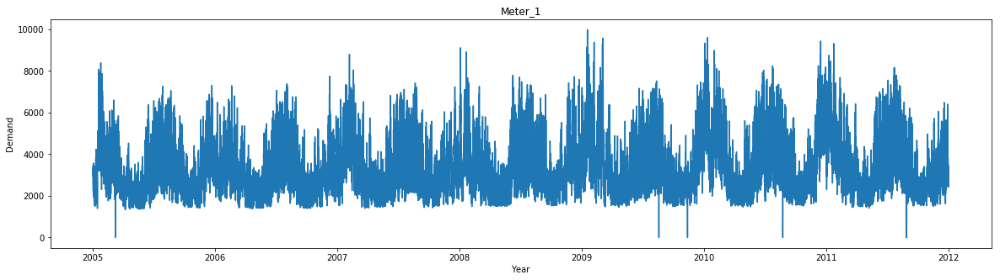

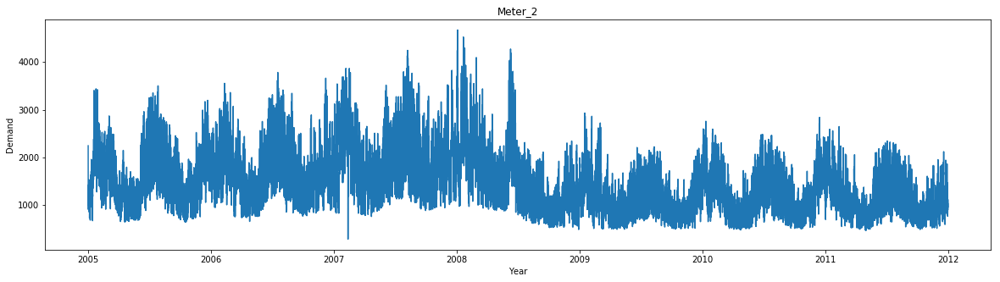

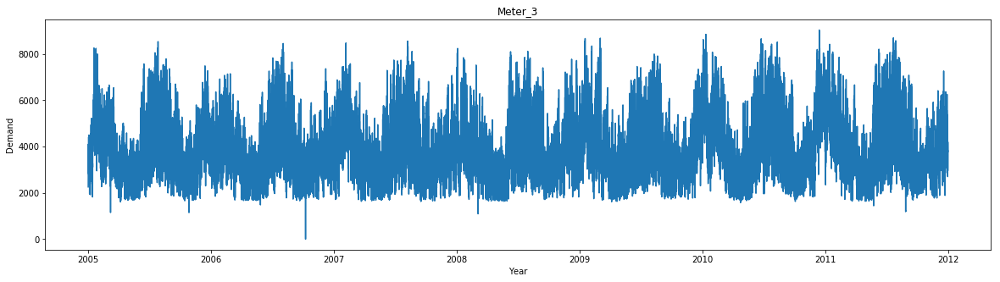

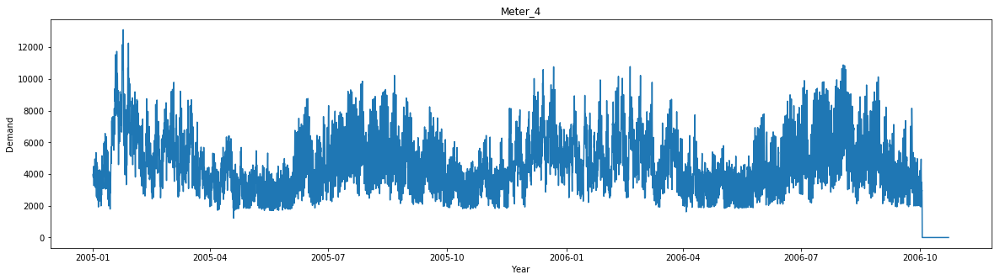

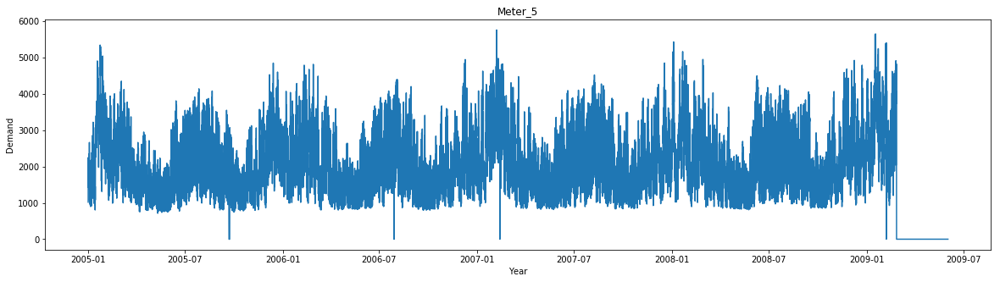

In [16]:
for i in np.arange(5)+1:
    plt.figure(figsize=(20,5))
    plt.plot(df[df.meter_id==i].date, df[df.meter_id==i].demand)
    plt.xlabel('Year')
    plt.ylabel('Demand')
    plt.title('Meter_'+i.astype(str))
    plt.show();

Electricity demand of first 5 meters exhibits seasonality with higher consumption during the winter and summer months. The demand of various meters, temperature, and humidity time-series lie in different ranges, therefore time-series will be normalized.

Investigate the length of historical data:

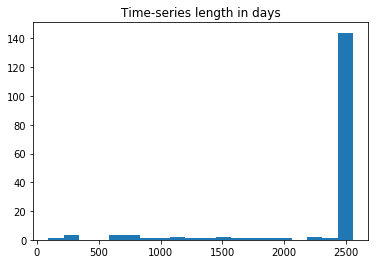

In [18]:
plt.hist(df.groupby('meter_id').date.count()/24, bins=20)
plt.title('Time-series length in days')
plt.show()

The number of unique meters in the data set:

In [19]:
len(df.meter_id.unique())

169

For the majority of meters, the length of historical data is about 2500 days.

Investigate seasonality:

In [21]:
demand_per_month = df.groupby(pd.DatetimeIndex(df['date']).month).mean()
demand_per_month = demand_per_month.drop('meter_id', axis=1)

In [22]:
demand_per_month_sd = df.groupby(pd.DatetimeIndex(df['date']).month).std()
demand_per_month_sd = demand_per_month_sd.drop('meter_id', axis=1)

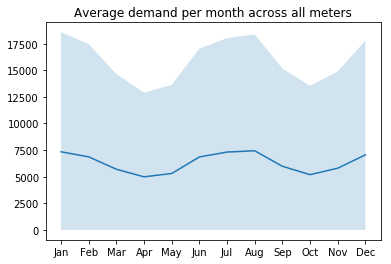

In [23]:
demand_per_month.index = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
demand_per_month_sd.index = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
plt.title('Average demand per month across all meters')
plt.xticks(demand_per_month.demand, demand_per_month.index.values) 
plt.plot(demand_per_month.demand)
plt.fill_between(demand_per_month.index.values, demand_per_month.demand+demand_per_month_sd.demand, alpha=0.2)
plt.xticks(np.arange(12), demand_per_month.index)
plt.show()

On average, there is a seasonality in the electricity demand time-series, i.e. load is higher in winter and during the summer months (potential impact of heating in winter and cooling in summer?).

Investigate trends in demand:

Compute a moving average of one month for each meter to smoothen the time-series and compare the demand for different meters.

Function to compute moving average:

In [25]:
def moving_avg(df, window_size):
    # Function returns a dataframe with a column containing moving average of demand
    # and its normalized values
    moving_avg_per_meter = df.groupby('meter_id').apply(lambda gr: gr.demand.rolling(window=window_size).mean())
    df['MovAvg'] = moving_avg_per_meter.values.reshape(-1,1)
    
    scaler = MinMaxScaler()
    meter_ids = df.meter_id.unique()
    normalized_avg = np.zeros(1)
    for id in meter_ids:
        meter_df = df[df['meter_id'] == id]
        normalized = scaler.fit_transform(meter_df.MovAvg.values.reshape(-1,1))
        normalized_avg = np.append(normalized_avg, normalized)

    # Drop first 0
    normalized_avg = normalized_avg[1:]
    df['normalized_avg'] = normalized_avg.reshape(-1,1)
    
    return df

Function to plot smoothed demand:

In [28]:
def plot_avg_demand(df, num_meters):
    # Plot demand of n meters per plot
    meter_ids = df.meter_id.unique()
    its = np.floor(len(meter_ids)/num_meters)
    start_ind = 0
    end_ind = start_ind + num_meters
    i = 0
    while i < its:
        i += 1
        
        plt.figure(figsize=(20,5))
        for id in meter_ids[start_ind:end_ind]:
            plt.plot(df[df.meter_id==id].date, df[df.meter_id==id].normalized_avg, marker='', linewidth=1, alpha=0.9, label=id)
            
        plt.legend(loc='upper right', ncol=2, bbox_to_anchor=(1.1, 1.05))
        plt.xlabel('Year')
        plt.ylabel('Normalized moving average')
        plt.show();
        
        start_ind = end_ind + 1
        end_ind = start_ind + num_meters

In [29]:
moving_avg(df, 24*30);

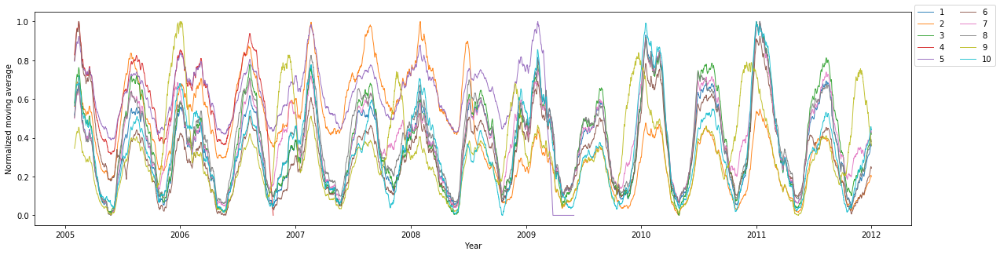

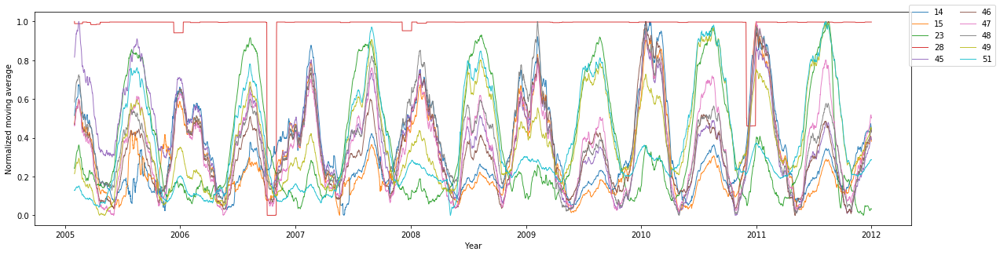

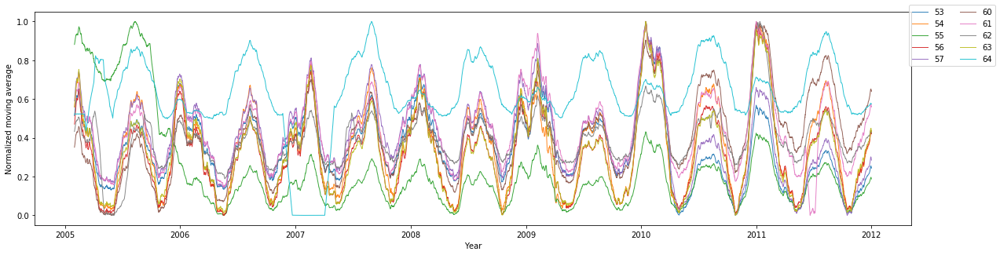

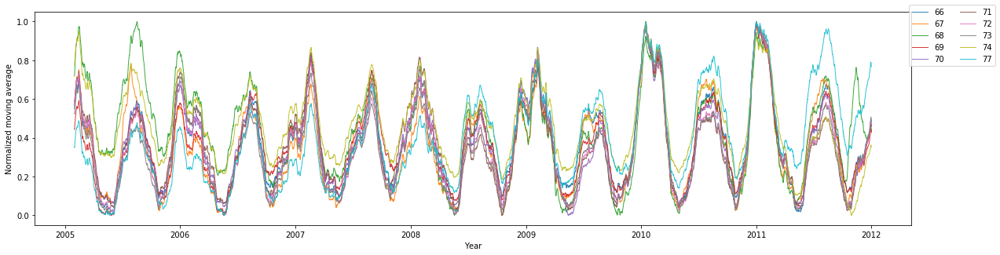

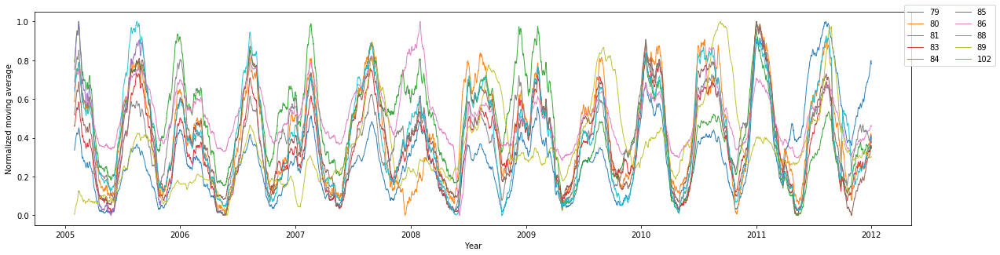

...

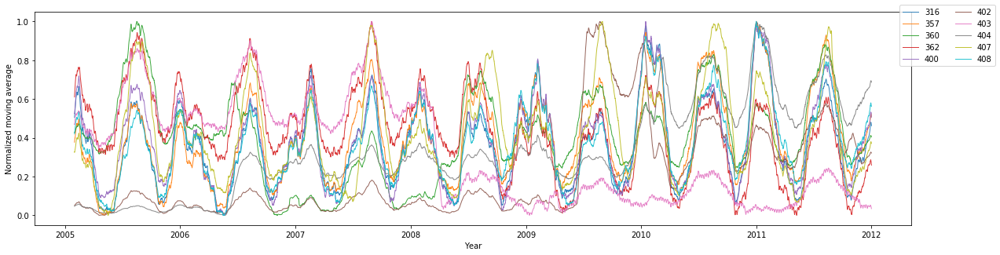

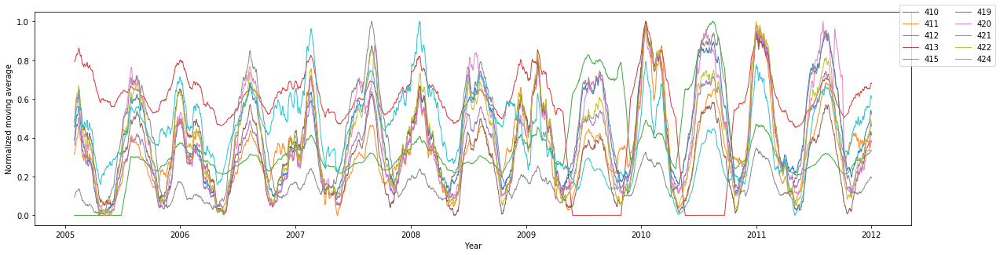

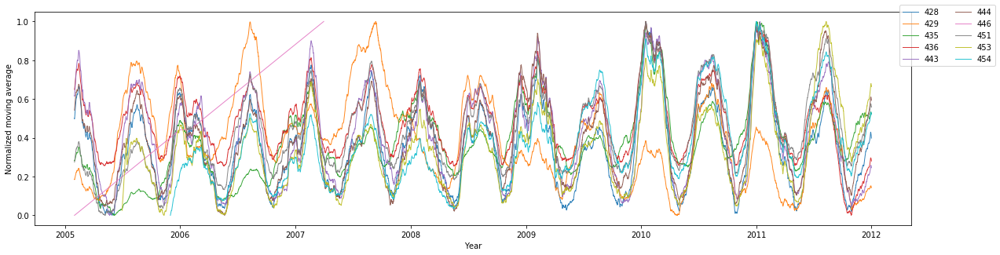

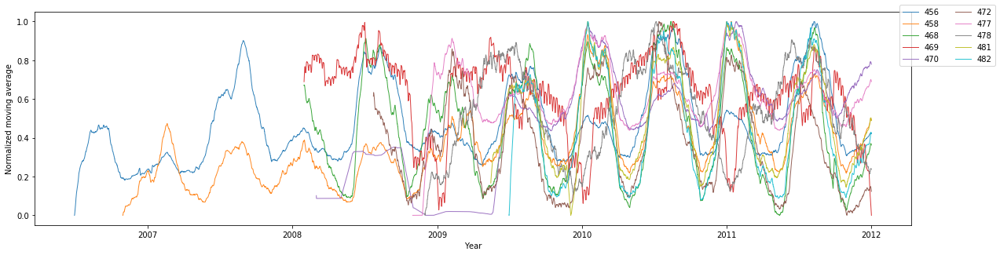

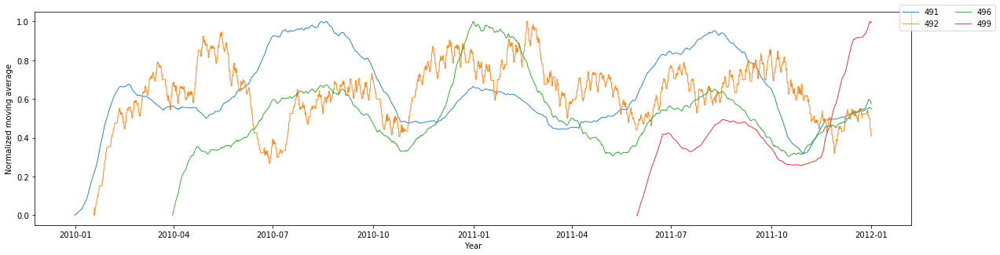

In [30]:
plot_avg_demand(df, 10)

When moving average of one month in demand for various meters is plotted, most of the time-series share the same shape and demonstrate seasonality. Very seldom (e.g., meter_id = 51) no seasonal pattern was observed. No consistent trends (e.g., average demand per month increases consistently from year to year) were observed. For some meters (e.g., meter_id = 2), a demand has dropped in the last couple of years.

Temperature and humidity time-series
--

__c. Analysis and removal of outliers in temperature and humidity time-series__

In [86]:
temperature = pd.read_pickle('temperature')

In [87]:
temperature.head(5)

,full_date,hourly_mean
0,2005-01-01 00:00:00,44.535714
1,2005-01-01 01:00:00,44.428571
2,2005-01-01 02:00:00,43.535714
3,2005-01-01 03:00:00,43.750000
4,2005-01-01 04:00:00,43.321429


In [88]:
temperature['diff_temp'] = temperature.hourly_mean.diff(periods=1)

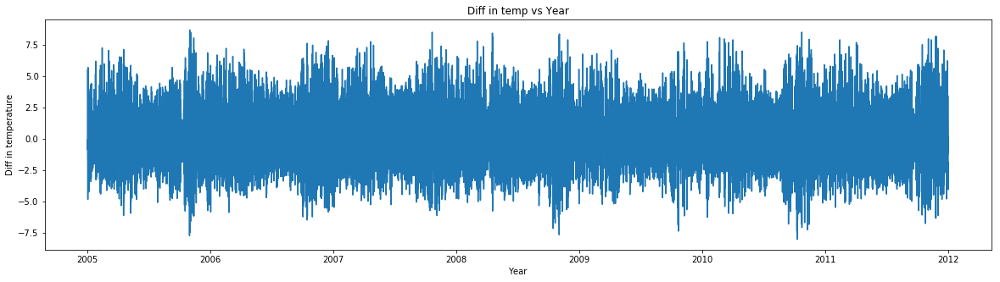

In [89]:
plt.figure(figsize=(20,5))
plt.plot(temperature.full_date, temperature.diff_temp)
plt.xlabel('Year')
plt.ylabel('Diff in temperature')
plt.title('Diff in temp vs Year')
plt.show();

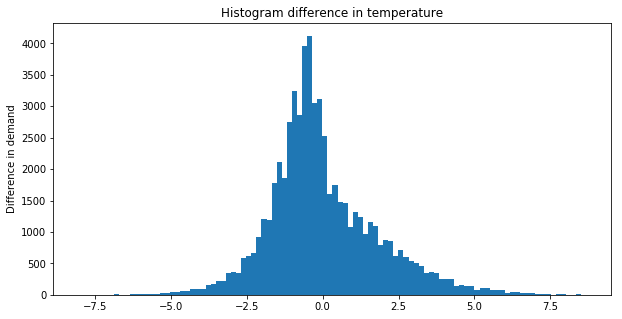

In [90]:
plt.figure(figsize=(10,5))
plt.hist(temperature.diff_temp, bins=100)
plt.ylabel('Difference in demand')
plt.title('Histogram difference in temperature')
plt.show();

Differences in temperature between 2 consecutive values seem to follow a normal distribution but no obvious outliers are detected visually.

In [91]:
mean_temp = temperature.hourly_mean.mean()
sd_temp = temperature.hourly_mean.std()

In [92]:
threshold = 3.0
temperature['not_outlier'] = np.abs(temperature.hourly_mean - mean_temp) < threshold*sd_temp

Replace outliers as an interpolation between 2 neighbouring values:

In [93]:
outlier_ind = temperature[temperature['not_outlier']==False].index
# Keep the very first element
col_ind = temperature.columns.get_loc('hourly_mean')
temperature.iloc[outlier_ind[1:], col_ind] = np.nan
temperature.hourly_mean.interpolate(inplace=True)

In [94]:
humidity = pd.read_pickle('humidity')

In [95]:
humidity.head(5)

,full_date,hourly_mean
0,2005-01-01 00:00:00,87.535714
1,2005-01-01 01:00:00,86.678571
2,2005-01-01 02:00:00,86.964286
3,2005-01-01 03:00:00,87.214286
4,2005-01-01 04:00:00,87.357143


In [96]:
humidity['diff_humidity'] = humidity.hourly_mean.diff(periods=1)

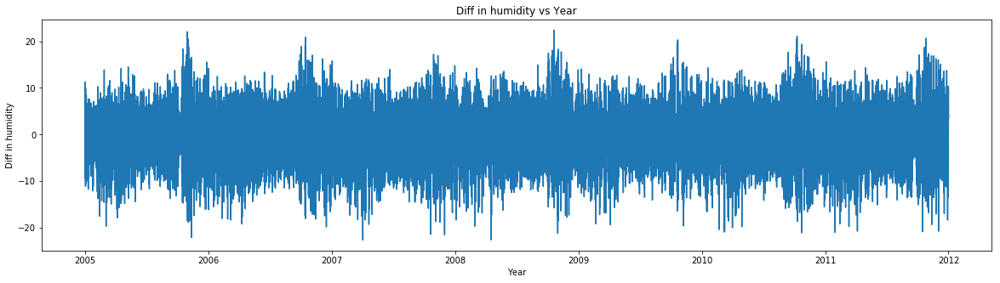

In [97]:
plt.figure(figsize=(20,5))
plt.plot(humidity.full_date, humidity.diff_humidity)
plt.xlabel('Year')
plt.ylabel('Diff in humidity')
plt.title('Diff in humidity vs Year')
plt.show();

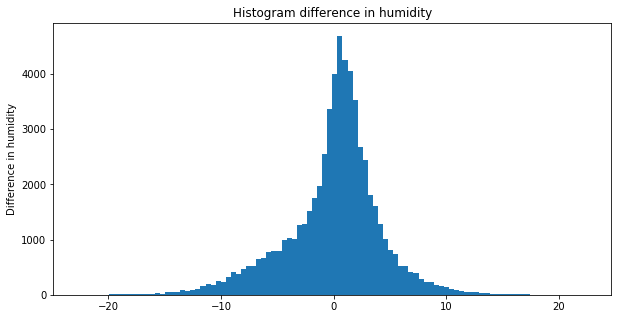

In [98]:
plt.figure(figsize=(10,5))
plt.hist(humidity.diff_humidity, bins=100)
plt.ylabel('Difference in humidity')
plt.title('Histogram difference in humidity')
plt.show();

Differences in humidity between 2 consecutive values seem to follow a normal distribution but no obvious outliers are detected visually.

In [99]:
mean_humidity = humidity.hourly_mean.mean()
sd_humidity = humidity.hourly_mean.std()

In [100]:
threshold = 3.0
humidity['not_outlier'] = np.abs(humidity.hourly_mean - mean_humidity) < threshold*sd_humidity

In [101]:
outlier_ind = humidity[humidity['not_outlier']==False].index
# Keep the very first element
col_ind = humidity.columns.get_loc('hourly_mean')
humidity.iloc[outlier_ind[1:], col_ind] = np.nan
humidity.hourly_mean.interpolate(inplace=True)

Normalize electricity demand, temperature, and humidity data
--

For clustering and modelling MinMax scaling will be applied to the electricity demand, temperature and humidity time-series.

In [102]:
scaler = MinMaxScaler()
meter_ids = df.meter_id.unique()
normalized_demand = np.zeros(1)
for id in meter_ids:
    meter_df = df[df['meter_id'] == id]
    normalized = scaler.fit_transform(meter_df.demand.values.reshape(len(meter_df.demand),1))
    normalized_demand = np.append(normalized_demand, normalized)
# Drop first 0
normalized_demand = normalized_demand[1:]
df['normalized_demand'] = normalized_demand

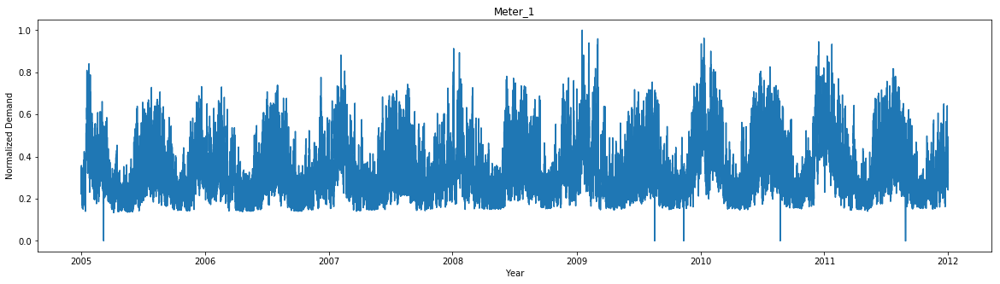

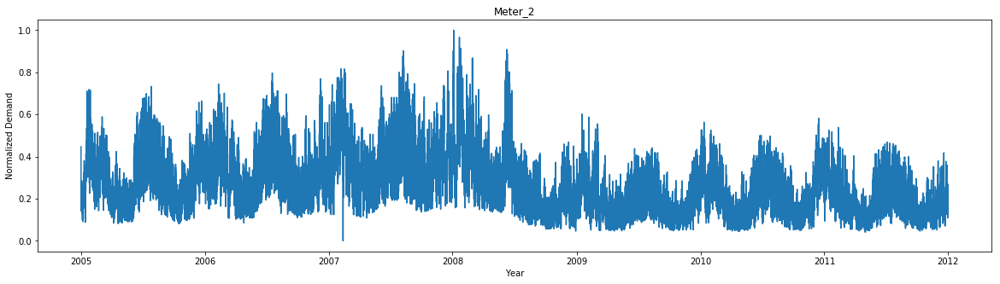

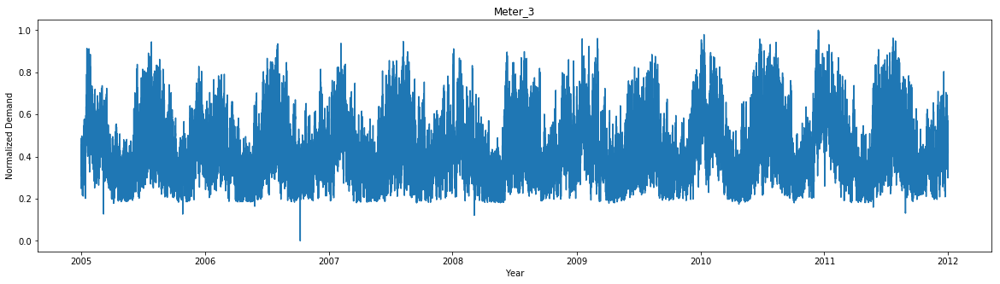

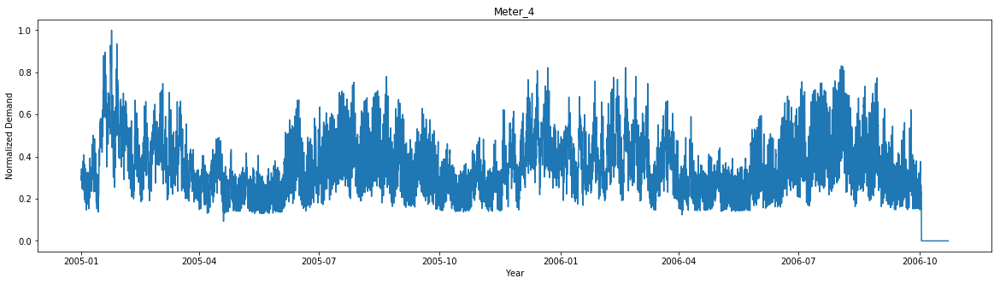

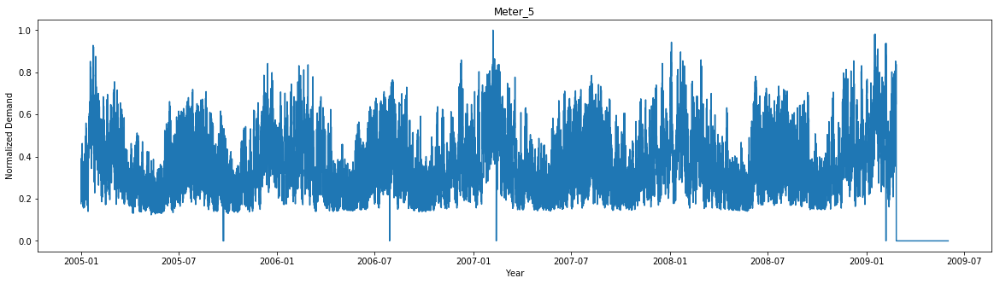

In [103]:
for i in np.arange(5)+1:
    plt.figure(figsize=(20,5))
    plt.plot(df[df.meter_id==i].date, df[df.meter_id==i].normalized_demand)
    plt.xlabel('Year')
    plt.ylabel('Normalized Demand')
    plt.title('Meter_'+i.astype(str))
    plt.show()

In [104]:
normalized_temp = scaler.fit_transform(temperature.hourly_mean.values.reshape(-1,1))
normalized_humidity = scaler.fit_transform(humidity.hourly_mean.values.reshape(-1,1))
temperature['normalized_temp'] = normalized_temp
humidity['normalized_humidity'] = normalized_humidity

Analysis of correlations between demand and weather time-series
--

Compute scatter plots between the electricity demand and temperature, electricity demand and humidity:

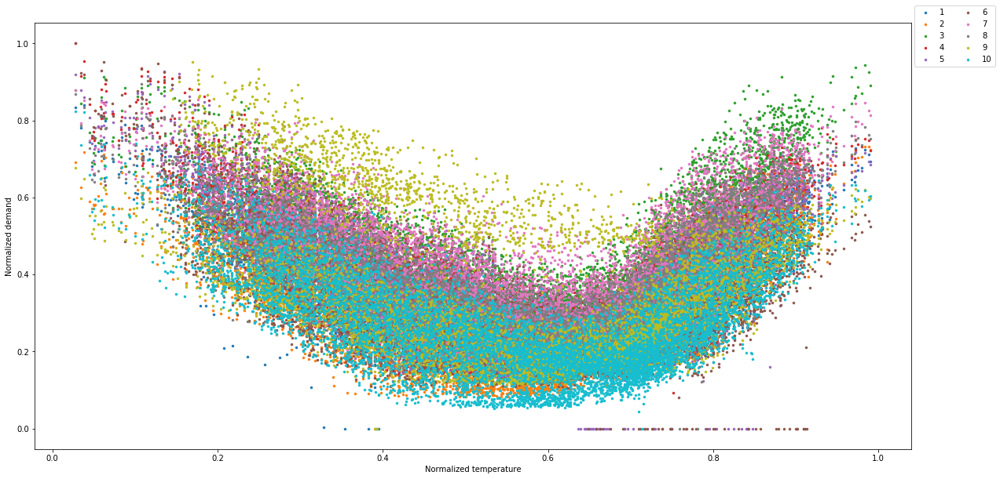

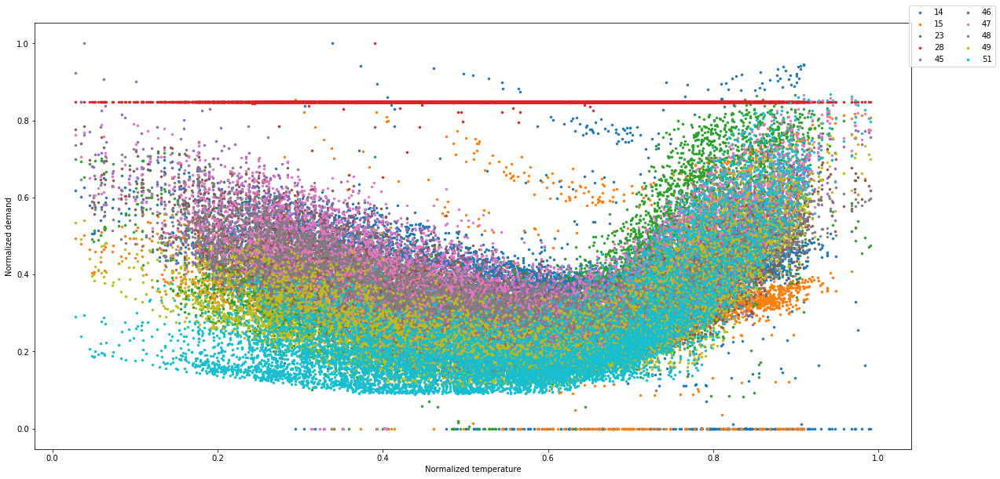

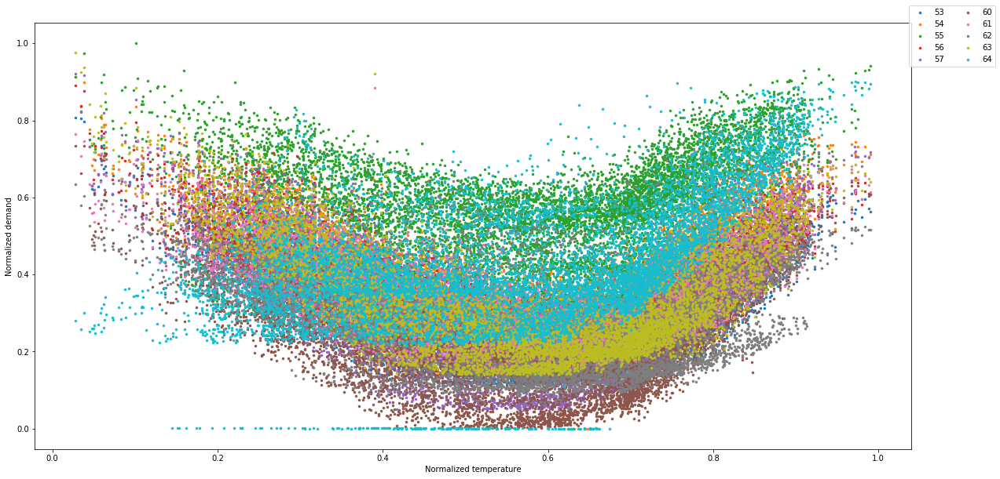

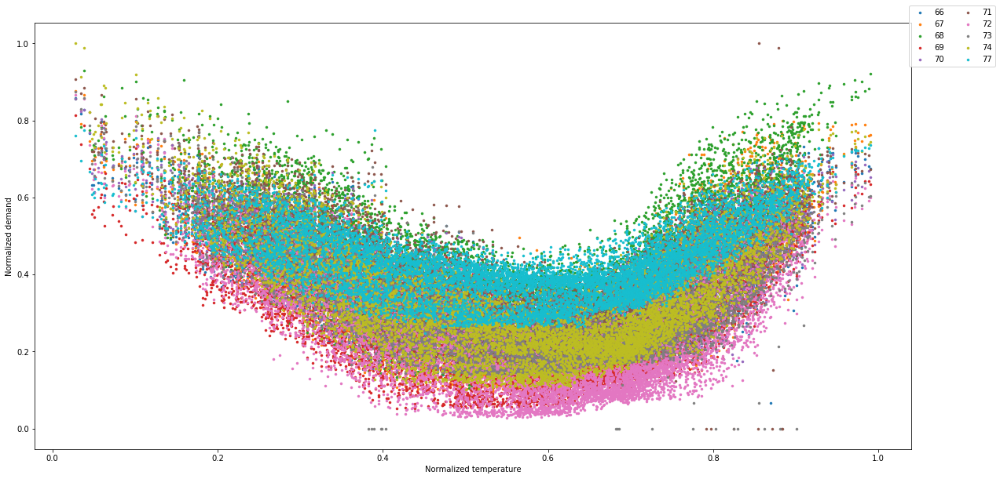

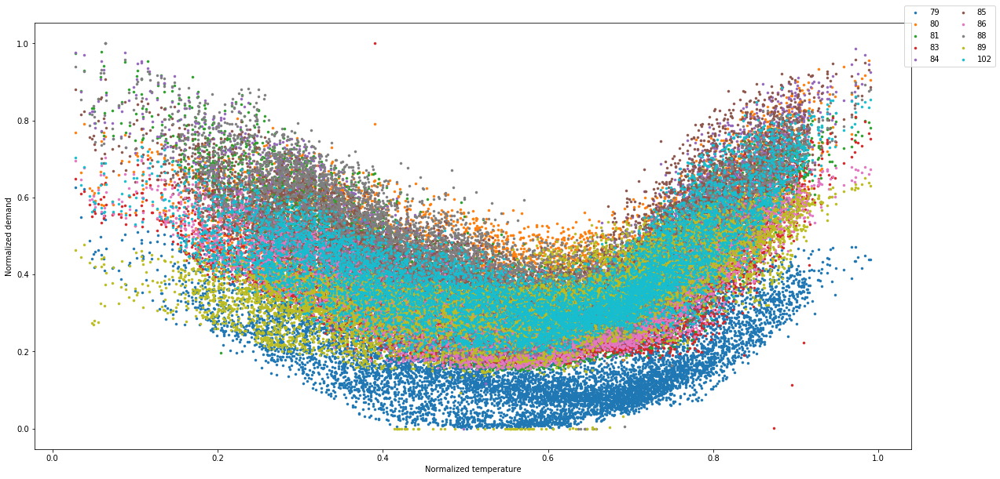

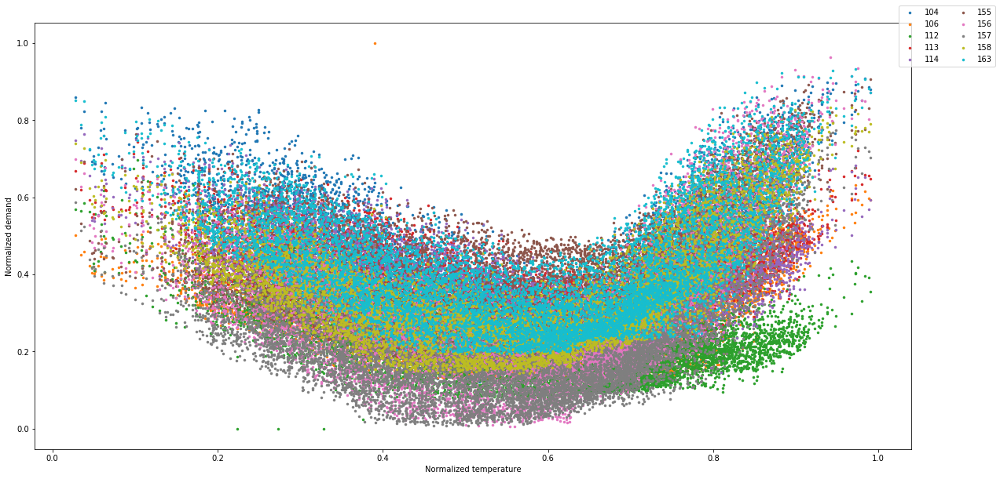

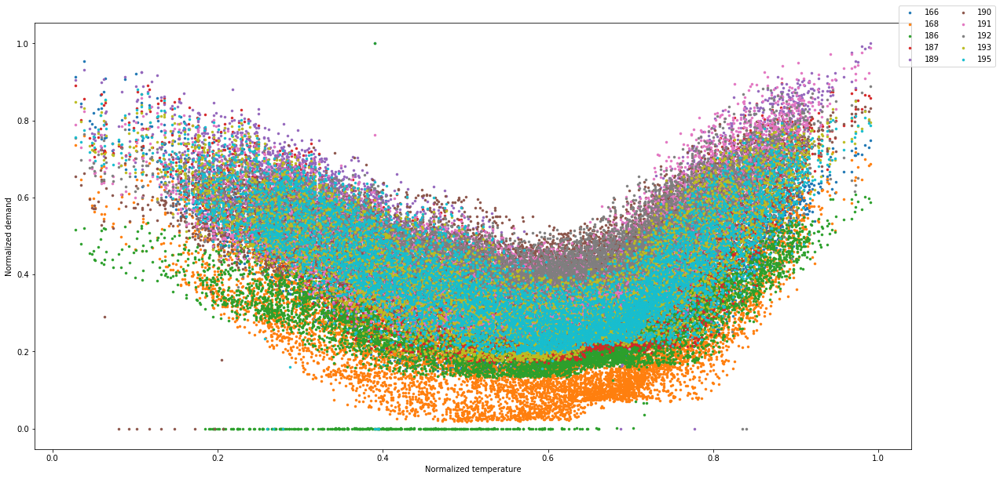

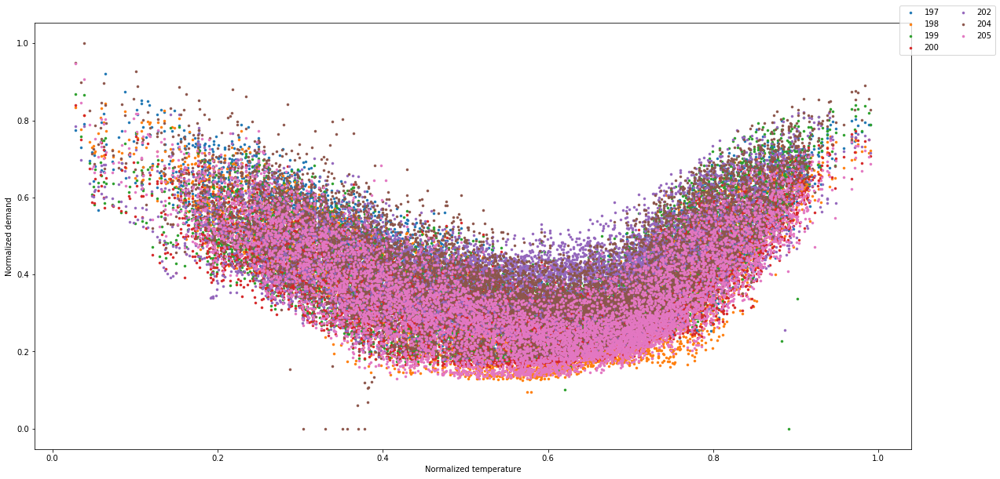

In [115]:
num_meters = 10
meter_ids = df.meter_id.unique()[0:84] # Plot only half of meters to reduce the size of notebook
its = np.floor(len(meter_ids)/num_meters)
start_ind = 0
end_ind = start_ind + num_meters
i = 0

while i < its:
    i += 1
    
    plt.figure(figsize=(20,10))
    for id in meter_ids[start_ind:end_ind]:
        dates = df[df.meter_id==id].date.reset_index()
        start = dates.date[0]
        # end = dates.date[len(dates)-1] # Uncomment to plot an entire data range
        end = start + pd.DateOffset(years=1) # Plot only one year of data
        temp = temperature[(temperature.full_date >= start) & (temperature.full_date <= end)]
        meter_df = df[df.meter_id==id]
        x = temp[temp.full_date.isin(meter_df.date)].normalized_temp
        y = meter_df[(meter_df.date >= start) & (meter_df.date <= end)].normalized_demand
        plt.scatter(x, y,linewidth=0.5,marker='.',label=id)
        
    plt.legend(loc='upper right', ncol=2, bbox_to_anchor=(1.1, 1.05))
    plt.xlabel('Normalized temperature')
    plt.ylabel('Normalized demand')
    plt.show();
        
    start_ind = end_ind + 1
    end_ind = start_ind + num_meters

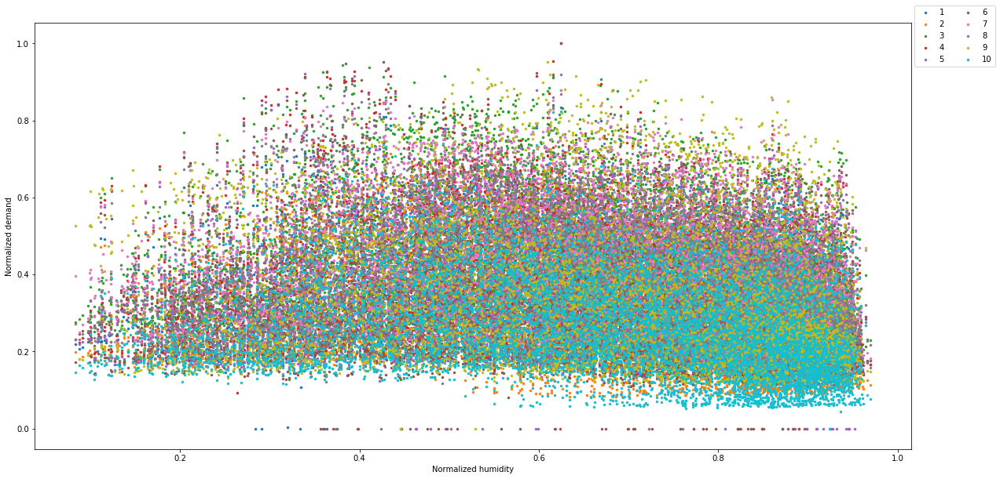

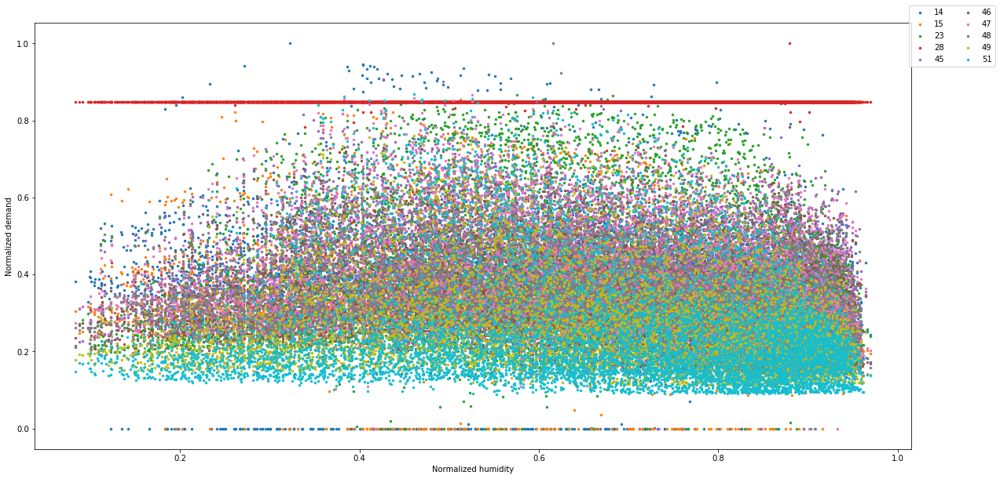

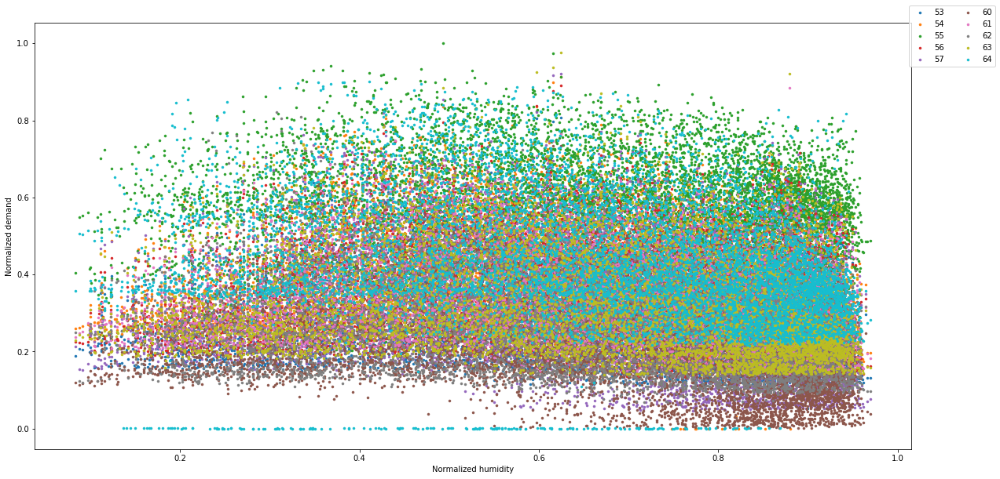

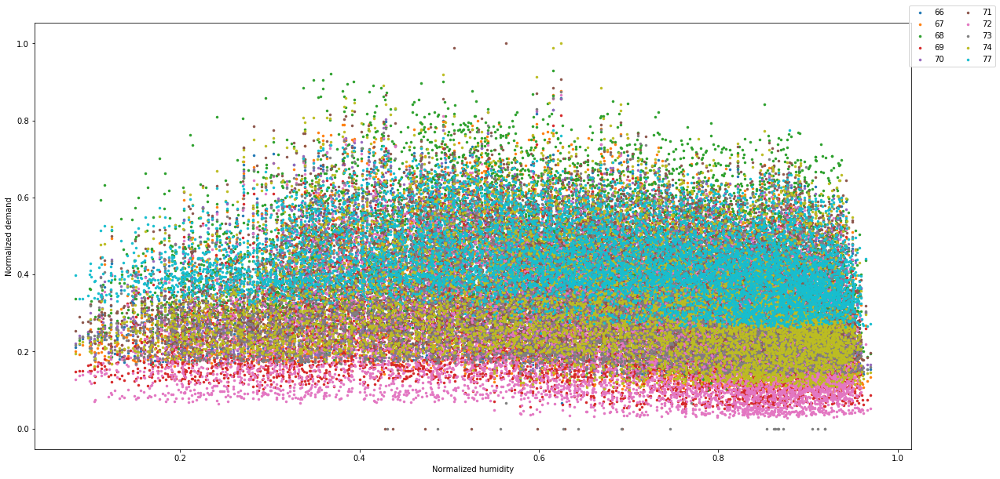

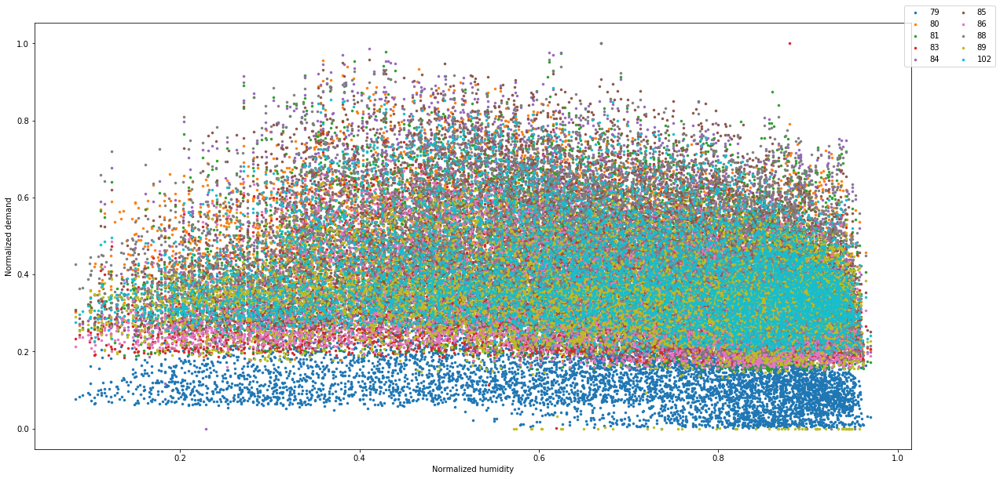

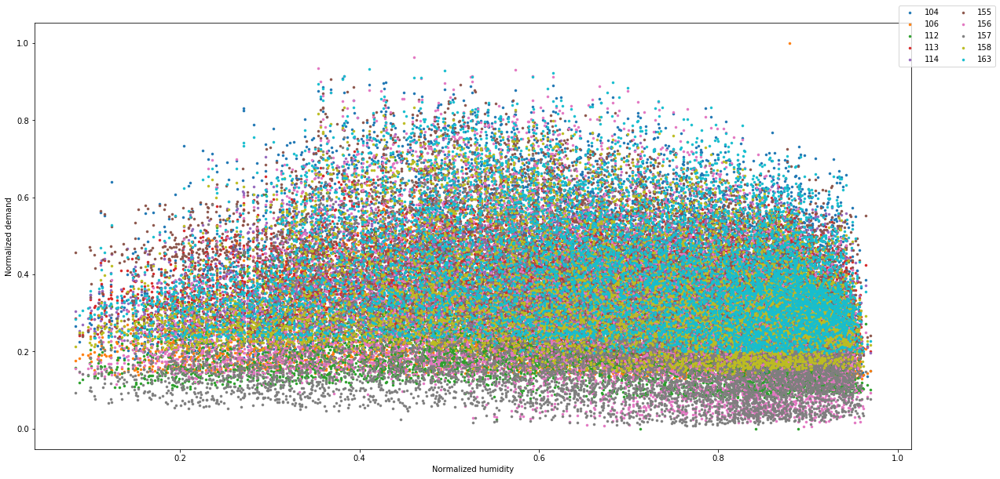

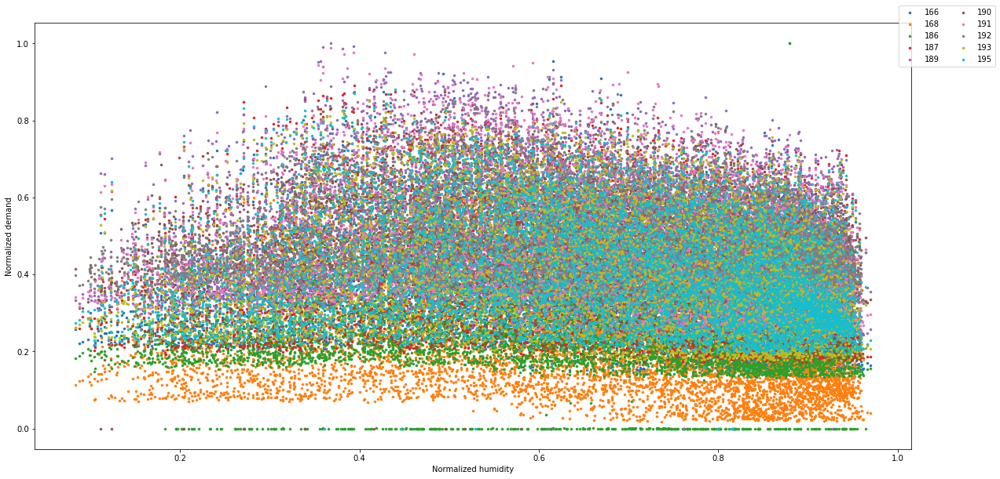

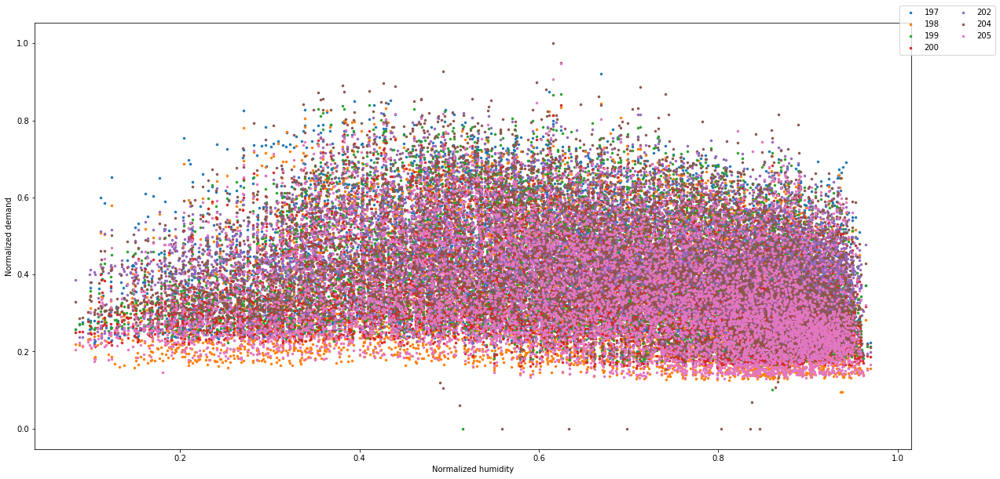

In [116]:
num_meters = 10
meter_ids = df.meter_id.unique()[0:84]
its = np.floor(len(meter_ids)/num_meters)
start_ind = 0
end_ind = start_ind + num_meters
i = 0

while i < its:
    i += 1
    
    plt.figure(figsize=(20,10))
    for id in meter_ids[start_ind:end_ind]:
        dates = df[df.meter_id==id].date.reset_index()
        start = dates.date[0]
        # end = dates.date[len(dates)-1] # Uncomment to plot an entire data range
        end = start + pd.DateOffset(years=1) # Plot only one year of data
        humid = humidity[(humidity.full_date >= start) & (humidity.full_date <= end)]
        meter_df = df[df.meter_id==id]
        meter_df = meter_df[meter_df.date.isin(humid.full_date)]
        x = humid[humid.full_date.isin(meter_df.date)].normalized_humidity
        y = meter_df[(meter_df.date >= start) & (meter_df.date <= end)].normalized_demand
        plt.scatter(x, y,linewidth=0.5,marker='.',label=id)
        
    plt.legend(loc='upper right', ncol=2, bbox_to_anchor=(1.1, 1.05))
    plt.xlabel('Normalized humidity')
    plt.ylabel('Normalized demand')
    plt.show();
        
    start_ind = end_ind + 1
    end_ind = start_ind + num_meters

For many meters very low and very high temperatures lead to an increased demand, the demand curves of these meters demonstrate seasonality. For the meters like 28, a sesonality was not observed in demand and there is no dependency on temperature. No obvious correlation was observed between normalized demand and normalized humidity.

/Users/anastasiagolubkova/anaconda3/envs/exts-ml/lib/python3.6/site-packages/ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


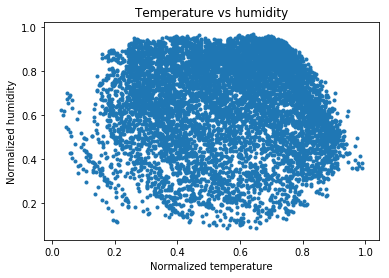

In [117]:
plt.scatter(temperature[(temperature.full_date >= start) & (temperature.full_date <= end)].normalized_temp, 
            humidity[(temperature.full_date >= start) & (temperature.full_date <= end)].normalized_humidity, marker='.')
plt.xlabel('Normalized temperature')
plt.ylabel('Normalized humidity')
plt.title('Temperature vs humidity')
plt.show()

No visual correlations were observed between temperature and humidity.

Compute correlations between the electricity demand, temperature and humidity for the 1st meter:

In [119]:
meter_1 = df[df.meter_id==1][['date','normalized_demand']]
meter_1['normalized_temp'] = temperature.normalized_temp
meter_1['normalized_humidity'] = humidity.normalized_humidity

In [120]:
meter_1.drop('date',axis=1).corr()

,normalized_demand,normalized_temp,normalized_humidity
normalized_demand,1.000000,-0.117396,-0.109743
normalized_temp,-0.117396,1.000000,0.104825
normalized_humidity,-0.109743,0.104825,1.000000


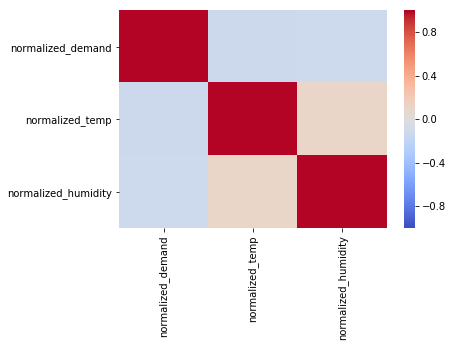

In [121]:
sns.heatmap(meter_1.drop('date',axis=1).corr(), vmin=-1, vmax=1, cmap="coolwarm");

For the first meter Pearson correlation coefficient was computed across an entire time range between the electricity demand, temperature, and humidity. Pearson correlation coefficient is computed for the assumed linear relations and since we didn't observe linear relations between demand, temperature, and humidity, the values of coefficient didn't provide any significant insight. Moreover, an autocorrelation in a demand time-series may have an impact on the correlation with other features.

Investigate the correlation between demand and a lag in demand. Plot demand vs demand with a lag of 12, 24, 48, and 168 hours for 5 randomly selected meters:

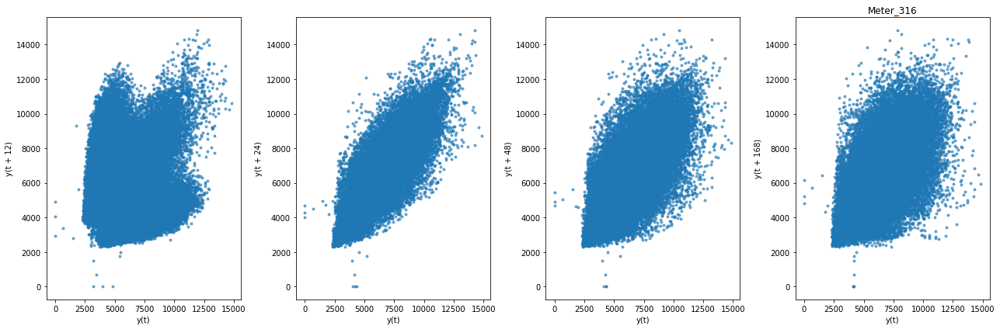

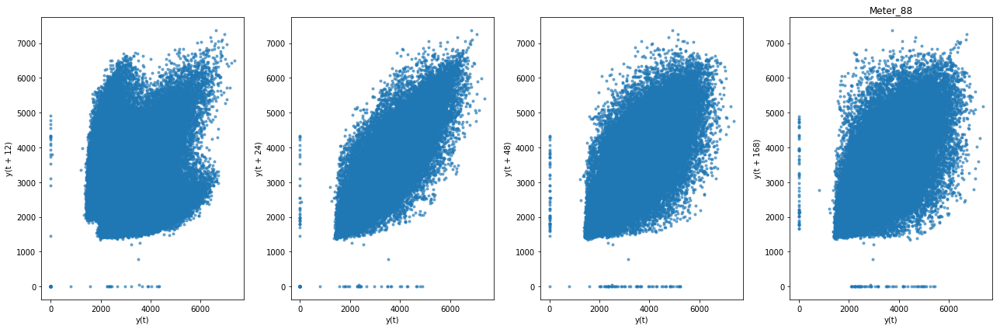

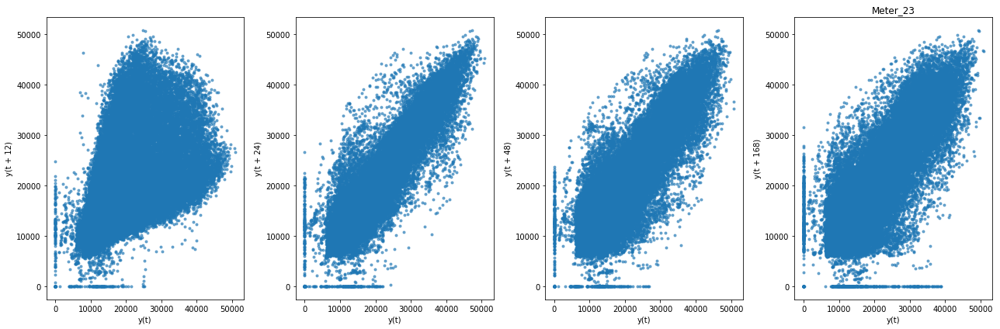

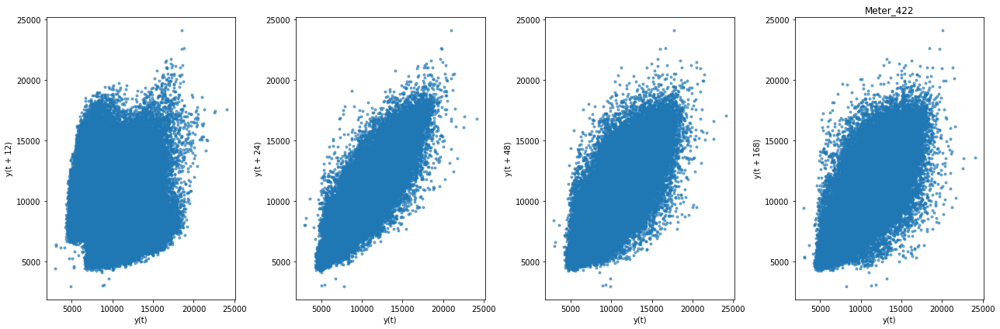

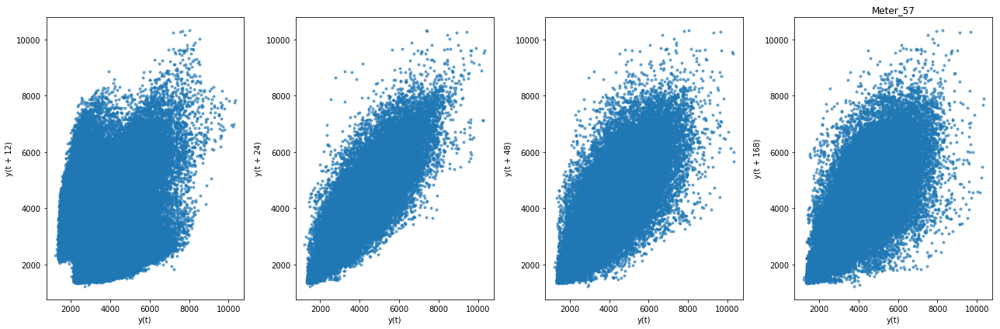

In [122]:
meter_ids = df.meter_id.unique()
rand_meters = np.random.choice(meter_ids, 5, replace=False)
lags = [12, 24, 48, 168]

for id in rand_meters:
    fig,axes = plt.subplots(1,4,figsize=(18,6))
    
    for lag,ax in zip(lags,axes.ravel()):
        pd.plotting.lag_plot(df[df['meter_id']==id]['demand'], lag=lag,ax=ax,alpha=0.6,marker='.')
    
    plt.title('Meter_'+str(id))
    plt.tight_layout();

In [123]:
df['demand-24h'] = df.groupby('meter_id')['demand'].apply(lambda gr: gr.shift(periods=24))

In [124]:
demand_lag = df[['meter_id','demand','demand-24h']].dropna()

Compute the Pearson correlation coefficient between the demand and demand with a 24-hours lag for each meter:

In [125]:
corr = []
for id in meter_ids:
    x = demand_lag[demand_lag['meter_id']==id].drop(['meter_id'], axis=1).corr()
    corr.append(x.iloc[0,1])
corr_df = pd.DataFrame({'meter_id':meter_ids, 'Pearson_corr_demand_t-24':corr});

In [126]:
corr_df.sort_values(by='Pearson_corr_demand_t-24',ascending=False).head(5)

,meter_id,Pearson_corr_demand_t-24
149,446,1.000000
126,402,0.969695
134,412,0.962252
116,303,0.960710
128,404,0.960531


In [127]:
corr_df.sort_values(by='Pearson_corr_demand_t-24',ascending=True).head(5)

,meter_id,Pearson_corr_demand_t-24
164,486,0.039732
14,28,0.071743
166,492,0.414664
86,208,0.560703
157,469,0.568667


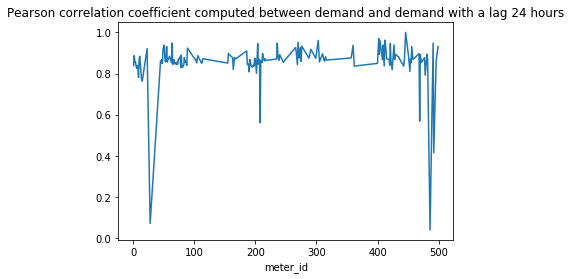

In [128]:
plt.plot(corr_df['meter_id'], corr_df['Pearson_corr_demand_t-24'])
plt.title('Pearson correlation coefficient computed between demand and demand with a lag 24 hours')
plt.xlabel('meter_id')
plt.xticks()
plt.show()

For many meters the value of Pearson correlation coefficient between demand and a 24-hours lag in demand is above 0.8. 24-hours lag in demand can be further used in a modelling as an additional feature. After a lag is computed, its values will be normalized: 

In [129]:
scaler = MinMaxScaler()
meter_ids = df.meter_id.unique()
normalized_lag = np.zeros(1)
for id in meter_ids:
    meter_df = df[df['meter_id'] == id]
    normalized = scaler.fit_transform(meter_df['demand-24h'].values.reshape(len(meter_df['demand-24h']),1))
    normalized_lag = np.append(normalized_lag, normalized)
# Drop first 0
normalized_lag = normalized_lag[1:]
df['normalized_demand-24h'] = normalized_lag

Save dataframes with removed outliers and normalized data:

In [131]:
df.drop(['diff_demand','not_outlier','diff_demand2','MovAvg','normalized_avg'], axis=1, inplace=True)

In [133]:
df.to_pickle('demand_data_for_modelling')

In [136]:
temperature.drop(['diff_temp','not_outlier'], axis=1, inplace=True)

In [137]:
temperature.to_pickle('temperature_for_modelling')

In [139]:
humidity.drop(['diff_humidity','not_outlier'],axis=1,inplace=True)

In [140]:
humidity.to_pickle('humidity_for_modelling')